
### Data Science Class with Onoja Anthony, PhD (Email: donmaston09@gmail.com)

#### Follow our Page on FaceBook: DataEdge Academy

#### Subscribe to our YouTube channel: @tonyonoja7880

#### Note: to run this script, you have to install the relevant Python packages and the datasets. Ensure to type "!pip install" in the Command Prompt (cmd) to install them . These includes:

    - pandas
    - numpy
    - scikit-learn
    - matplotlib
    - seaborn
    - shap
    - lime 



### Recap: SHAP (SHapley Additive exPlanations)

- Based on Game Theory: SHAP values are derived from cooperative game theory and calculate the contribution of each feature to the prediction.
    Global and Local Interpretability: SHAP can explain individual predictions (local) as well as provide feature importance rankings (global).
    Model-Agnostic: It works with any machine learning model.
- Advantages:
        Provides consistent and additive feature attributions.
        Offers a comprehensive global understanding of the model.
- Common Use-Cases:
        Explaining complex models like random forests, gradient boosting, and neural networks.
        Comparing feature contributions across different instances.


### LIME (Local Interpretable Model-agnostic Explanations)

Local Interpretability: LIME approximates the behavior of a machine learning model around a single instance by training a simpler interpretable model (like linear regression or decision trees).
Perturbation-Based: It perturbs the input data to observe changes in predictions and fit the local surrogate model.
- Advantages:
        Fast and simple to implement.
        Works well when you want to explain a specific prediction rather than the entire model.
- Common Use-Cases:
        Explaining predictions for text classification, image classification, and tabular data models.
#### Limitations


- Instability:
        LIME can produce different explanations for slightly different runs or perturbations of the input data. This is because it relies on randomly generated perturbations to create a surrogate model.

- Locality:
        LIME is designed to explain predictions locally (i.e., for a single instance). It does not provide a global understanding of the model or how features interact across the entire dataset.

- Dependency on Perturbations:
        The quality of LIME's explanations depends on how the input data is perturbed. Poorly chosen perturbations may lead to inaccurate or misleading explanations.

- Surrogate Model Simplification:
        LIME uses a simpler model (e.g., linear regression) as a surrogate to approximate the complex model’s behavior locally. This simplification might not always capture the true nature of the model's behavior.

- Feature Independence Assumption:
        LIME assumes that features are independent when perturbing the data, which might not hold true for datasets with strong feature correlations.

- Computational Cost:
        For large datasets or very complex models, creating enough meaningful perturbations and training the local surrogate model can be computationally expensive.

- Interpretability vs. Fidelity Trade-off:
        The surrogate model used in LIME is interpretable but may have low fidelity to the original model, especially for highly nonlinear models.

- Sensitivity to Parameters:
        LIME requires careful tuning of parameters, such as the number of perturbations and the kernel width for weighting perturbed instances. Poor parameter choices can degrade explanation quality.

- High-Dimensional Data Challenges:
        For datasets with a large number of features, interpreting the results of LIME can become cumbersome, as it may highlight many features as important in the local explanation.

- Limited Support for Sequential and Structured Data:
        While LIME works well with tabular, image, and text data, it has limitations when dealing with sequential or structured data (e.g., time series, nested data) unless significant preprocessing is applied.



### Classification Example: Binary Case

### 1) Breast Cancer Classification Problem 

#### Introduction:

The Breast Cancer dataset from Scikit-learn is a widely used dataset for binary classification tasks. Here's a brief introduction:

Objective: The goal is to classify tumors as malignant (cancerous) or benign (non-cancerous) based on various features derived from digitized images of breast tissue.

#### Dataset Size:
Samples: 569 instances.
Features: 30 numerical features, including measurements like radius, texture, perimeter, area, smoothness, compactness, concavity, symmetry, and fractal dimension.
Classes: 2 (Malignant = 1, Benign = 0).

#### Features:
All features are real-valued and continuous.
They represent various properties of cell nuclei present in the image.

#### Target Variable:
0: Benign (non-cancerous).
1: Malignant (cancerous).

##### Source:
The dataset is originally from the University of Wisconsin Hospitals, Madison.

Use Case: The dataset is commonly used for:
Binary classification model training.
- Evaluating algorithms.
- Practicing interpretability techniques like SHAP and LIME.


In [91]:
### Load the relevant packages 

# Import libraries
import shap
import lime.lime_tabular
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import load_breast_cancer
from sklearn.metrics import accuracy_score

#### Load the Dataset

In [92]:
from sklearn.datasets import load_breast_cancer

# Step 1: Load Breast Cancer Dataset
data = load_breast_cancer()

# Convert to DataFrame
df = pd.DataFrame(data.data, columns=data.feature_names)
df['target'] = data.target  # Add target column

### Perform EDA 

In [93]:
# Quick view of the dataset
print(df.head())
print(df.info())


   mean radius  mean texture  mean perimeter  mean area  mean smoothness  \
0        17.99         10.38          122.80     1001.0          0.11840   
1        20.57         17.77          132.90     1326.0          0.08474   
2        19.69         21.25          130.00     1203.0          0.10960   
3        11.42         20.38           77.58      386.1          0.14250   
4        20.29         14.34          135.10     1297.0          0.10030   

   mean compactness  mean concavity  mean concave points  mean symmetry  \
0           0.27760          0.3001              0.14710         0.2419   
1           0.07864          0.0869              0.07017         0.1812   
2           0.15990          0.1974              0.12790         0.2069   
3           0.28390          0.2414              0.10520         0.2597   
4           0.13280          0.1980              0.10430         0.1809   

   mean fractal dimension  ...  worst texture  worst perimeter  worst area  \
0             


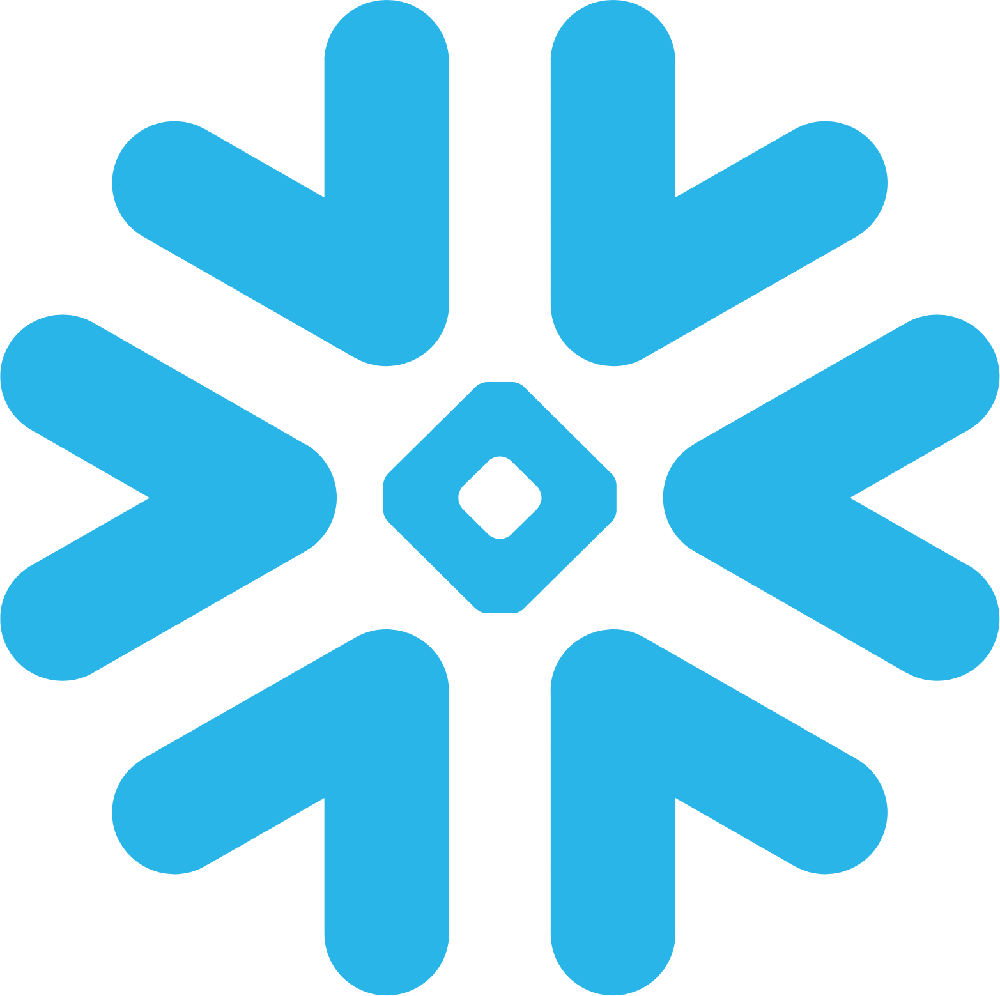

In [94]:
df.describe() #check for descriptive stats

In [95]:
#### Missing Values

# Check missing values
print(df.isnull().sum())

mean radius                0
mean texture               0
mean perimeter             0
mean area                  0
mean smoothness            0
mean compactness           0
mean concavity             0
mean concave points        0
mean symmetry              0
mean fractal dimension     0
radius error               0
texture error              0
perimeter error            0
area error                 0
smoothness error           0
compactness error          0
concavity error            0
concave points error       0
symmetry error             0
fractal dimension error    0
worst radius               0
worst texture              0
worst perimeter            0
worst area                 0
worst smoothness           0
worst compactness          0
worst concavity            0
worst concave points       0
worst symmetry             0
worst fractal dimension    0
target                     0
dtype: int64


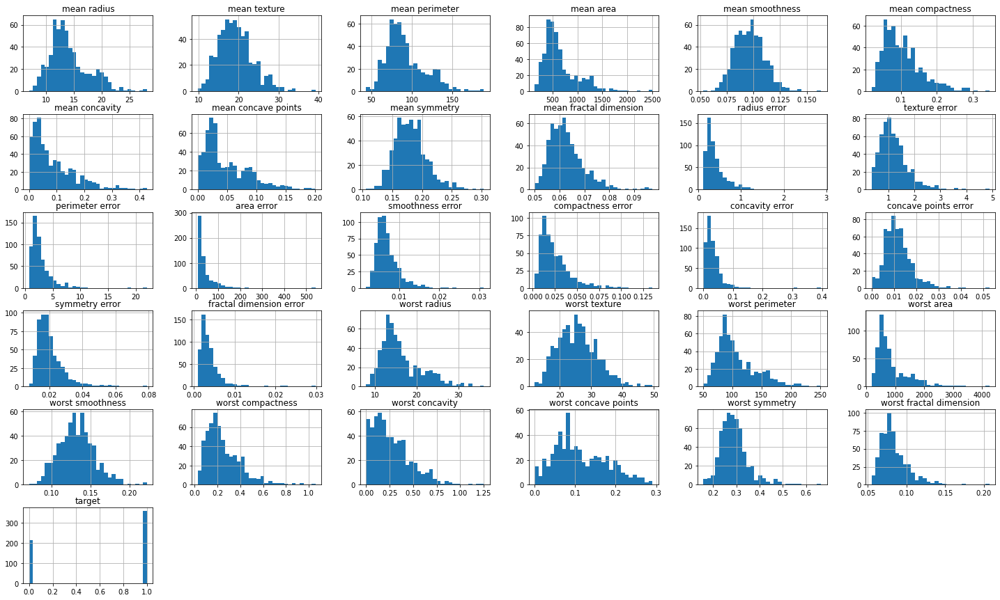

In [96]:
# Numerical Features
import matplotlib.pyplot as plt
df.hist(figsize=(25, 15), bins=30)
plt.show()

# Categorical Features
for col in df.select_dtypes(include=['object']).columns:
    sns.countplot(y=col, data=df)
    plt.show()

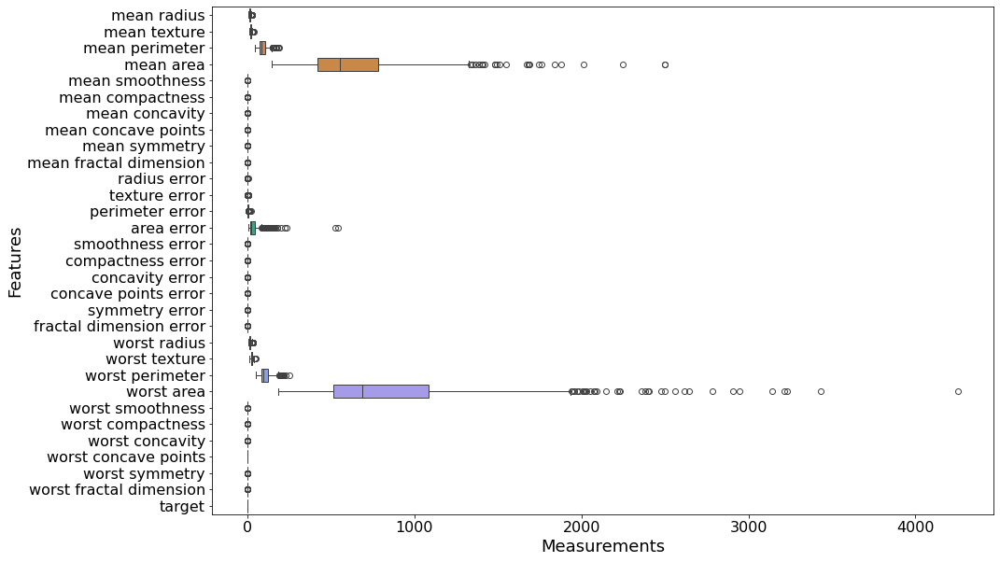

In [98]:
# Box plots of the dataset
import seaborn as sns
plt.figure(figsize=(15, 10))  # Adjust width and height as needed

# Boxplot for outliers
sns.boxplot(data=df, orient="h")
# Increase font sizes
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
# Set axis titles and font sizes
plt.xlabel("Measurements", fontsize=18)
plt.ylabel("Features", fontsize=18)
plt.show()


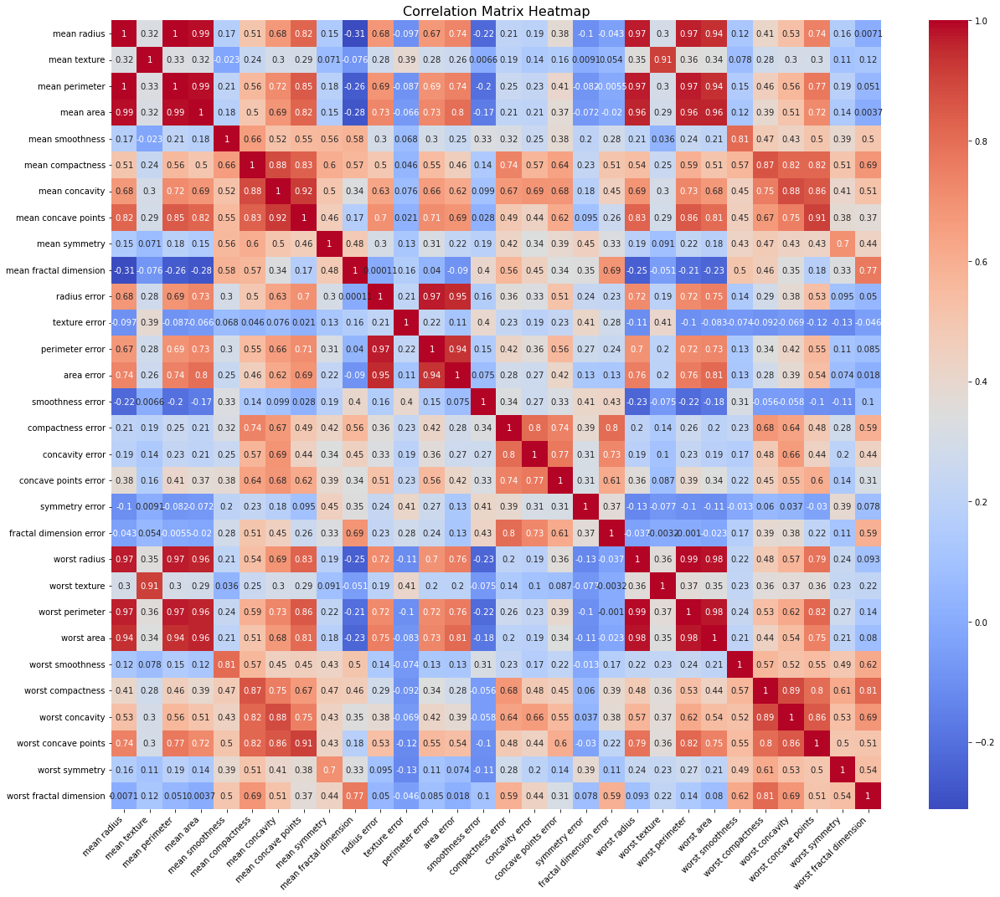

In [99]:
# Drop the 'target' column for correlation matrix
feature_df = df.drop('target', axis=1)

# Plot Correlation Matrix Heatmap
plt.figure(figsize=(18, 15))
corr_matrix = feature_df.corr()
ax = sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')

# Set title
plt.title("Correlation Matrix Heatmap", fontsize=16)

# Rotate x-axis labels with alignment
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right', fontsize=10)
ax.set_yticklabels(ax.get_yticklabels(), fontsize=10)

plt.tight_layout()
plt.show()


### Modelling Phase

In [101]:
# Define features and target from DataFrame
X = df.drop('target', axis=1)
y = df['target']

In [102]:
# Step 2: Split into 80% Train and 20% Test Sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [103]:
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.metrics import classification_report

In [104]:
# Standardize features (excluding target)
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

# Scale the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

### Random Forest Classifier

In [105]:
df['target'].value_counts()

target
1    357
0    212
Name: count, dtype: int64

In [106]:
### Train Random Forest classifier with Grid Search CV 

# Define parameter grid
rf_param_grid = {
    'n_estimators': [100, 200],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5]
}

# Create GridSearchCV
rf_grid = GridSearchCV(RandomForestClassifier(random_state=42), rf_param_grid, cv=5, scoring='accuracy') #Feel free to check other measures like f1-score
rf_grid.fit(X_train_scaled, y_train)

# Best model
best_rf = rf_grid.best_estimator_
print("Best Random Forest Parameters:", rf_grid.best_params_)

# Evaluate
y_pred_rf = best_rf.predict(X_test_scaled)
print("\nRandom Forest Classification Report:")
print(classification_report(y_test, y_pred_rf))


Best Random Forest Parameters: {'max_depth': None, 'min_samples_split': 2, 'n_estimators': 200}

Random Forest Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.93      0.95        43
           1       0.96      0.99      0.97        71

    accuracy                           0.96       114
   macro avg       0.97      0.96      0.96       114
weighted avg       0.97      0.96      0.96       114



#### Global Explanations: feature Importance scores

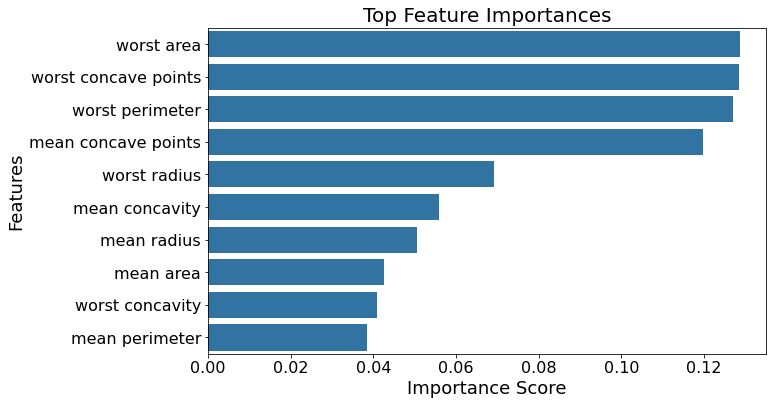

In [107]:
importances_rf = best_rf.feature_importances_
indices_rf = np.argsort(importances_rf)[::-1]
top_n = 10  # change as needed

plt.figure(figsize=(10, 6))
sns.barplot(
    x=importances_rf[indices_rf[:top_n]],
    y=X.columns[indices_rf[:top_n]]
)
plt.title("Top Feature Importances", fontsize=20)
plt.xlabel("Importance Score", fontsize=18)
plt.ylabel("Features", fontsize=18)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.show()


### AUROC Curve Analysis

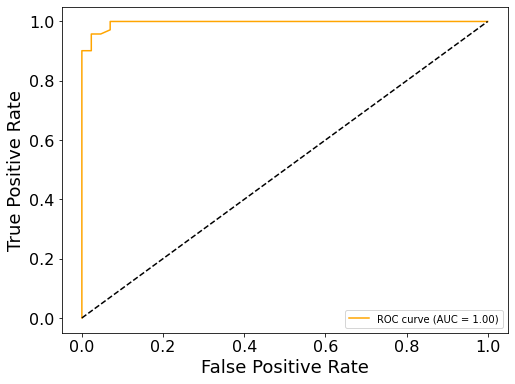

In [108]:
from sklearn.metrics import roc_curve, auc

# Predict probabilities
y_rf_probs = best_rf.predict_proba(X_test_scaled)[:, 1]

# Compute ROC curve and AUC
fpr_rf, tpr_rf, _ = roc_curve(y_test, y_rf_probs)
roc_auc_rf = auc(fpr_rf, tpr_rf)

# Plot
plt.figure(figsize=(8, 6))
plt.plot(fpr_rf, tpr_rf, color='orange', label=f'ROC curve (AUC = {roc_auc_rf:.2f})')
plt.plot([0, 1], [0, 1], 'k--')  # Random guess
plt.xlabel('False Positive Rate', fontsize=18)
plt.ylabel('True Positive Rate', fontsize=18)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
#plt.title('ROC Curve - Random Forest')
plt.legend(loc='lower right')
plt.grid(False)
plt.show()


### XGBoost Classifier

In [109]:
# Define parameter grid
xgb_param_grid = {
    'n_estimators': [100, 200],
    'max_depth': [3, 6],
    'learning_rate': [0.05, 0.1]
}

# Create GridSearchCV
xgb_grid = GridSearchCV(XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42),
                        xgb_param_grid, cv=5, scoring='accuracy')
xgb_grid.fit(X_train_scaled, y_train)

# Best model
best_xgb = xgb_grid.best_estimator_
print("Best XGBoost Parameters:", xgb_grid.best_params_)

# Evaluate
y_pred_xgb = best_xgb.predict(X_test_scaled)
print("\nXGBoost Classification Report:")
print(classification_report(y_test, y_pred_xgb))


C:\Users\Hp\anaconda3\Lib\site-packages\xgboost\core.py:158: UserWarning: [14:05:37] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
C:\Users\Hp\anaconda3\Lib\site-packages\xgboost\core.py:158: UserWarning: [14:05:37] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
C:\Users\Hp\anaconda3\Lib\site-packages\xgboost\core.py:158: UserWarning: [14:05:38] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
C:\Users\Hp\anaconda3\Lib\site-packages\xgboost\core

Best XGBoost Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200}

XGBoost Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.93      0.94        43
           1       0.96      0.97      0.97        71

    accuracy                           0.96       114
   macro avg       0.96      0.95      0.95       114
weighted avg       0.96      0.96      0.96       114



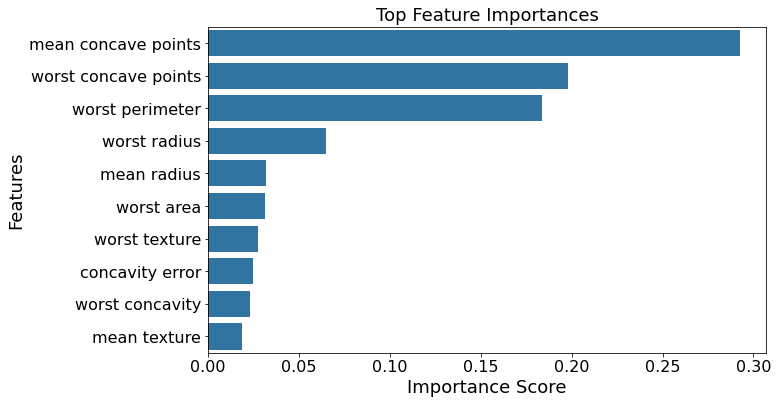

In [110]:
# Feature Importance Analysis
importances_xgb = best_xgb.feature_importances_
indices_xgb = np.argsort(importances_xgb)[::-1]

plt.figure(figsize=(10, 6))
sns.barplot(
    x=importances_xgb[indices_xgb[:top_n]],
    y=X.columns[indices_xgb[:top_n]]
)
plt.title("Top Feature Importances", fontsize=18)
plt.xlabel("Importance Score")
plt.ylabel("Features")
plt.xlabel("Importance Score", fontsize=18)
plt.ylabel("Features", fontsize=18)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.show()


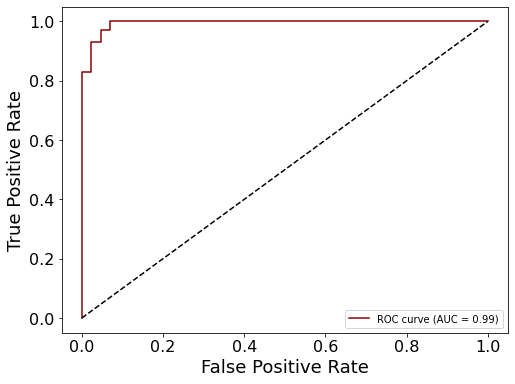

In [111]:
# Predict probabilities
y_xgb_probs = best_xgb.predict_proba(X_test_scaled)[:, 1]

# Compute ROC curve and AUC
fpr_xgb, tpr_xgb, _ = roc_curve(y_test, y_xgb_probs)
roc_auc_xgb = auc(fpr_xgb, tpr_xgb)

# Plot
plt.figure(figsize=(8, 6))
plt.plot(fpr_xgb, tpr_xgb, color='darkred', label=f'ROC curve (AUC = {roc_auc_xgb:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate', fontsize=18)
plt.ylabel('True Positive Rate', fontsize=18)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
#plt.title('ROC Curve - XGBoost')
plt.legend(loc='lower right')
plt.grid(False)
plt.show()


#### Post-Hoc Model Interpretations

In [112]:
# Step 4: SHAP Explanation
print("\n=== SHAP ===")
explainer_shap = shap.TreeExplainer(best_xgb)
shap_values = explainer_shap.shap_values(X_test_scaled)


=== SHAP ===


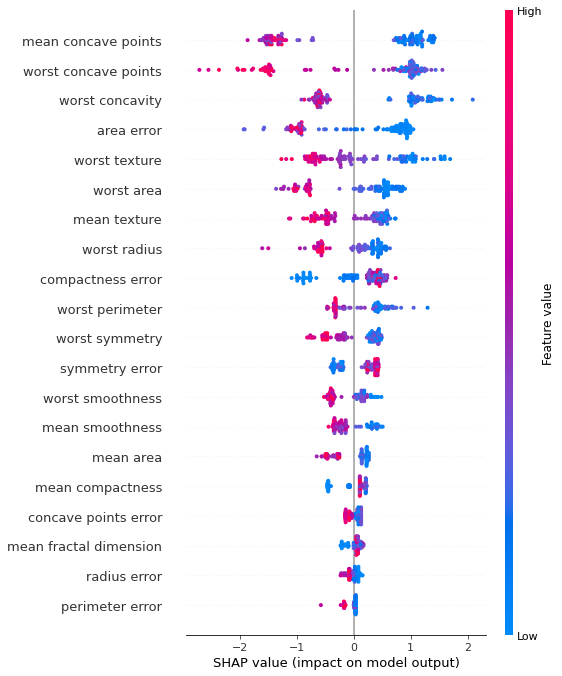

In [113]:
# Visualize Global Feature Importance (SHAP)
feature_names = X.columns
# Visualize SHAP values for binary classification
shap.summary_plot(shap_values, X_test_scaled, feature_names=feature_names)

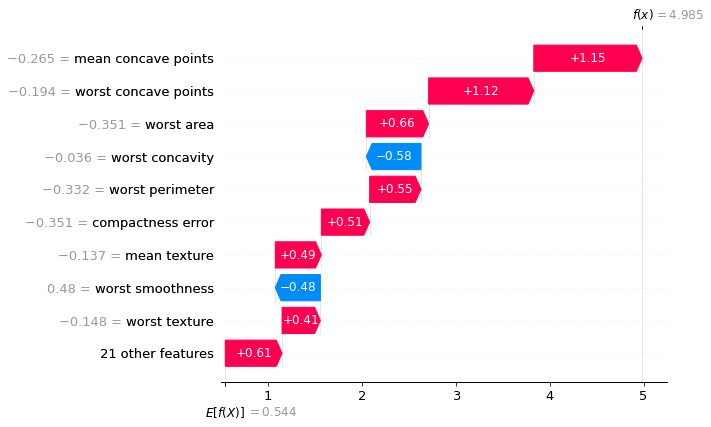

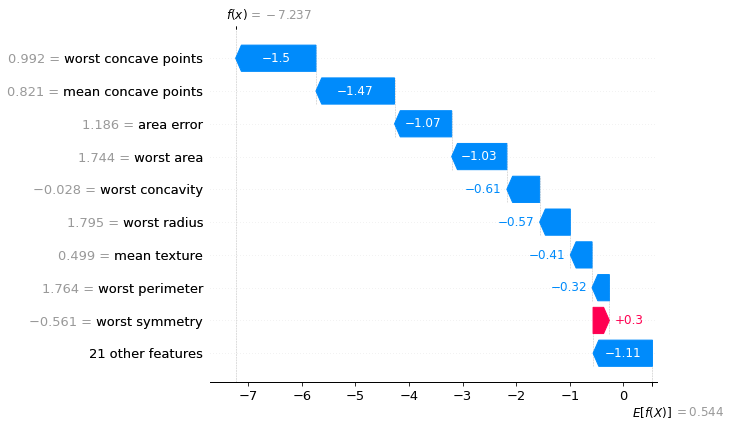

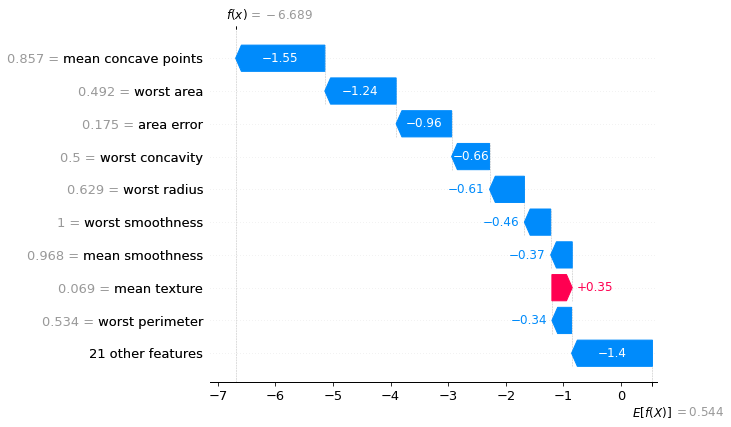

In [114]:
# Visualize Waterfall plots for the first 3 test samples
for sample_idx in range(3):
    shap_values_sample = shap.Explanation(
        values=shap_values[sample_idx], 
        base_values=explainer_shap.expected_value,  # Direct scalar use
        data=X_test_scaled[sample_idx], 
        feature_names=feature_names
    )
    shap.waterfall_plot(shap_values_sample)


In [115]:
X.columns

Index(['mean radius', 'mean texture', 'mean perimeter', 'mean area',
       'mean smoothness', 'mean compactness', 'mean concavity',
       'mean concave points', 'mean symmetry', 'mean fractal dimension',
       'radius error', 'texture error', 'perimeter error', 'area error',
       'smoothness error', 'compactness error', 'concavity error',
       'concave points error', 'symmetry error', 'fractal dimension error',
       'worst radius', 'worst texture', 'worst perimeter', 'worst area',
       'worst smoothness', 'worst compactness', 'worst concavity',
       'worst concave points', 'worst symmetry', 'worst fractal dimension'],
      dtype='object')

### LIME Explanations

In [116]:
import lime
import lime.lime_tabular
import numpy as np
import matplotlib.pyplot as plt

In [117]:
# Create the Lime explainer
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train_scaled,         # Directly use the scaled training data (no need for .values)
    training_labels=y_train,              # The corresponding labels
    mode='classification',                # For classification task
    feature_names=X.columns,              # The feature names
    class_names=['Benign', 'Malignant'],  # The classes in your dataset
    discretize_continuous=True            # Optionally discretize continuous variables
)


In [118]:
# Get the prediction for this instance (using numpy indexing)
instance_idx = 0
instance = X_test_scaled[instance_idx]  # This is how you index numpy arrays

# Explain the prediction using LIME
explanation = explainer.explain_instance(
    instance,                           # Instance to explain (no .values needed for numpy arrays)
    best_xgb.predict_proba,             # The model's prediction probabilities
    num_features=10                     # Number of features to show in explanation
)


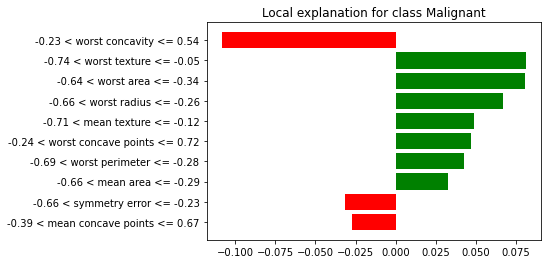

In [119]:
### Visualise explanations

explanation.show_in_notebook()  # If you're working in a Jupyter notebook

# Or you can plot it in a separate window
explanation.as_pyplot_figure()
plt.show()


In [120]:
#### Multiple Instances

# Convert X_test_scaled to a pandas DataFrame
X_test_scaled_df = pd.DataFrame(X_test_scaled, columns=X.columns)

# Loop through multiple instances for explanation
for instance_idx in range(5):  # Let's explain the first 5 instances
    instance = X_test_scaled_df.iloc[instance_idx]  # Use iloc since it's now a DataFrame
    explanation = explainer.explain_instance(
        instance.values,  # Use .values for the row of data
        best_xgb.predict_proba,
        num_features=10
    )
    explanation.show_in_notebook()  # Or use .as_pyplot_figure() for pyplot


#### Multiclass Problem Example

The Wine dataset from the UCI Machine Learning Repository is a classic dataset used for multiclass classification tasks. It involves classifying wines into one of three classes based on their chemical properties.

- Objective: Predict the class of wine (Class 0, Class 1, or Class 2) based on chemical analysis.
- Number of Classes: 3 (Class 0, Class 1, Class 2).
- Number of Features: 13 numerical features, including alcohol content, malic acid, ash, magnesium, flavonoids, phenols, and others.
- Dataset Size: 178 samples.
- Use Case: Commonly used for classification algorithm evaluation, feature importance analysis, and interpretability studies.


In [121]:
from sklearn.datasets import load_wine

# Load Wine dataset
data = load_wine()
X = pd.DataFrame(data.data, columns=data.feature_names)
y = pd.Series(data.target, name="target")

In [122]:
# Combine features and target into one DataFrame
df = pd.concat([X, y], axis=1)

In [123]:
# Inspect the dataset
print("First few rows of the dataset:")
print(df.head())

First few rows of the dataset:
   alcohol  malic_acid   ash  alcalinity_of_ash  magnesium  total_phenols  \
0    14.23        1.71  2.43               15.6      127.0           2.80   
1    13.20        1.78  2.14               11.2      100.0           2.65   
2    13.16        2.36  2.67               18.6      101.0           2.80   
3    14.37        1.95  2.50               16.8      113.0           3.85   
4    13.24        2.59  2.87               21.0      118.0           2.80   

   flavanoids  nonflavanoid_phenols  proanthocyanins  color_intensity   hue  \
0        3.06                  0.28             2.29             5.64  1.04   
1        2.76                  0.26             1.28             4.38  1.05   
2        3.24                  0.30             2.81             5.68  1.03   
3        3.49                  0.24             2.18             7.80  0.86   
4        2.69                  0.39             1.82             4.32  1.04   

   od280/od315_of_diluted_wines

In [124]:
print("\nDataset Info:")
print(df.info())


Dataset Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 178 entries, 0 to 177
Data columns (total 14 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   alcohol                       178 non-null    float64
 1   malic_acid                    178 non-null    float64
 2   ash                           178 non-null    float64
 3   alcalinity_of_ash             178 non-null    float64
 4   magnesium                     178 non-null    float64
 5   total_phenols                 178 non-null    float64
 6   flavanoids                    178 non-null    float64
 7   nonflavanoid_phenols          178 non-null    float64
 8   proanthocyanins               178 non-null    float64
 9   color_intensity               178 non-null    float64
 10  hue                           178 non-null    float64
 11  od280/od315_of_diluted_wines  178 non-null    float64
 12  proline                       178 non-null    flo


Summary Statistics:



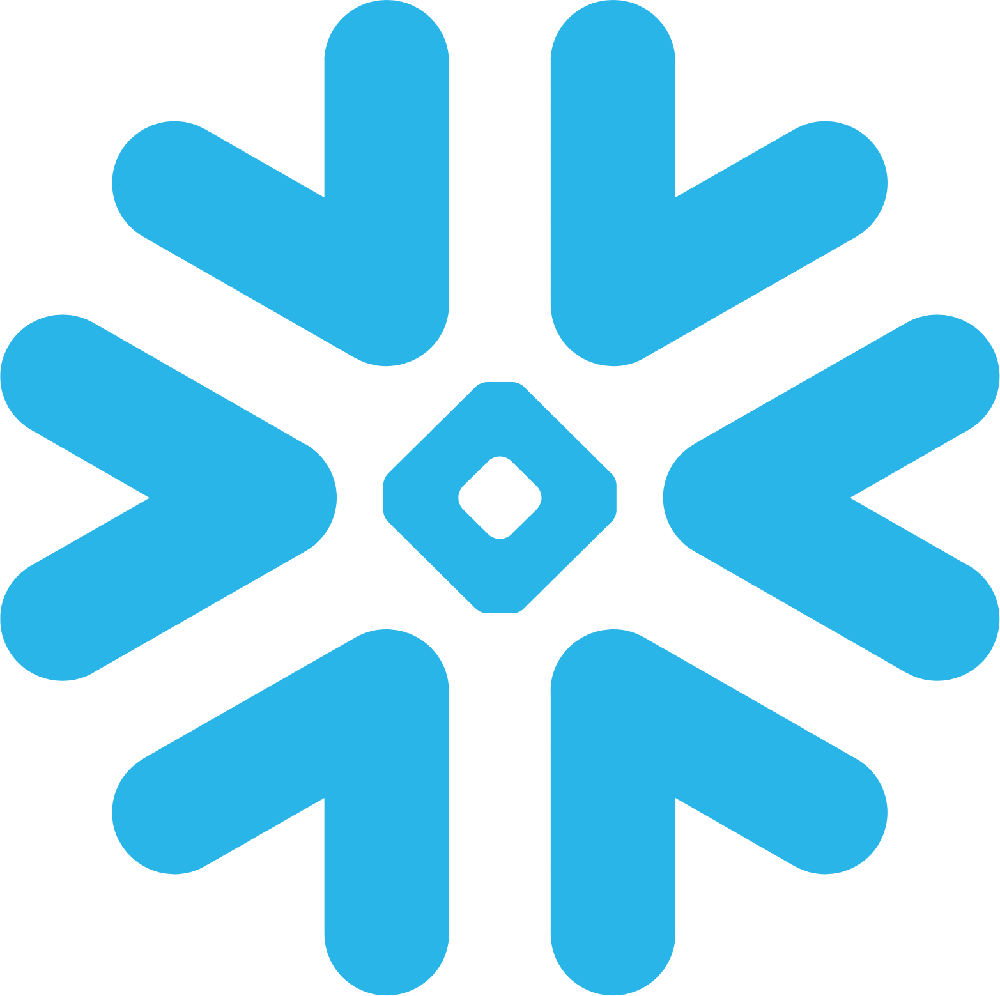

In [125]:
print("\nSummary Statistics:")
df.describe()

In [126]:
df['target'].value_counts()

target
1    71
0    59
2    48
Name: count, dtype: int64

C:\Users\Hp\AppData\Local\Temp\ipykernel_23752\3476091610.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='target', data=df, palette='viridis')


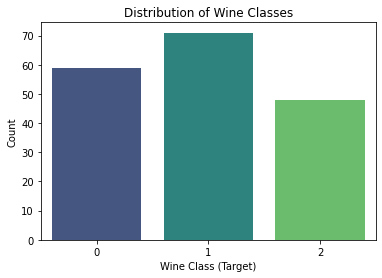

In [127]:
# Plot the target variable distribution
sns.countplot(x='target', data=df, palette='viridis')
plt.title("Distribution of Wine Classes")
plt.xlabel("Wine Class (Target)")
plt.ylabel("Count")
plt.show()

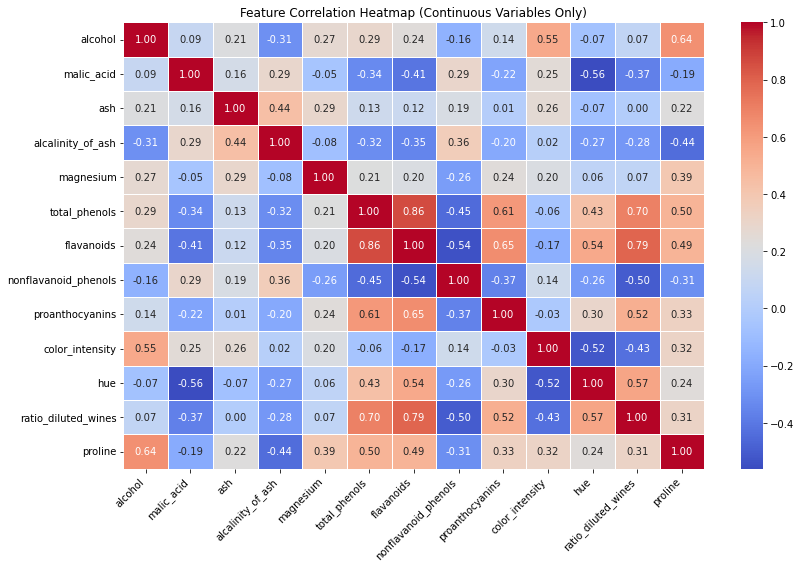

In [133]:
### Make correlation Heat map
# Drop the target column and select only numeric (continuous) features
continuous_features = df.drop(columns=['target']).select_dtypes(include=['float64', 'int64'])

# Calculate the correlation matrix
corr_matrix = continuous_features.corr()

plt.figure(figsize=(12, 8))
ax = sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title("Feature Correlation Heatmap (Continuous Variables Only)")
plt.xticks(rotation=45, ha='right')  # Slant x-axis labels
plt.yticks(rotation=0)               # Keep y-axis labels horizontal
plt.tight_layout()                   # Adjust layout to prevent clipping
plt.show()


In [131]:
df.columns

Index(['alcohol', 'malic_acid', 'ash', 'alcalinity_of_ash', 'magnesium',
       'total_phenols', 'flavanoids', 'nonflavanoid_phenols',
       'proanthocyanins', 'color_intensity', 'hue',
       'od280/od315_of_diluted_wines', 'proline', 'target'],
      dtype='object')

In [132]:
df.rename(columns={'od280/od315_of_diluted_wines': 'ratio_diluted_wines'}, inplace=True)

In [134]:
df.columns

Index(['alcohol', 'malic_acid', 'ash', 'alcalinity_of_ash', 'magnesium',
       'total_phenols', 'flavanoids', 'nonflavanoid_phenols',
       'proanthocyanins', 'color_intensity', 'hue', 'ratio_diluted_wines',
       'proline', 'target'],
      dtype='object')

C:\Users\Hp\AppData\Local\Temp\ipykernel_23752\3606865679.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='target', y='alcohol', data=df, palette='viridis')


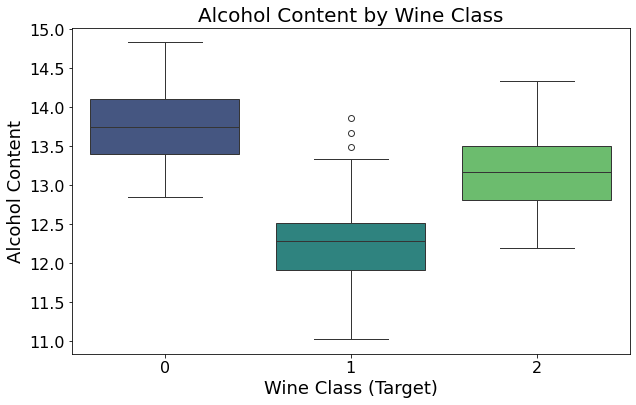

In [135]:
# Boxplot for a specific feature by target
plt.figure(figsize=(10, 6))
sns.boxplot(x='target', y='alcohol', data=df, palette='viridis')
plt.title("Alcohol Content by Wine Class", fontsize=20)
plt.xlabel("Wine Class (Target)", fontsize=18)
plt.ylabel("Alcohol Content", fontsize=18)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.show()

#### Modelling Phase

In [136]:
# Select features and response variables for ML training task 

X = df.drop('target', axis=1)
y = df['target']

In [137]:
# Step 2: Split into 80% Train and 20% Test Sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [138]:
# Scale the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

### Train Random Forest with GridSearchCV

In [139]:
rf = RandomForestClassifier(random_state=42, class_weight='balanced')

param_grid_rf = {
    'n_estimators': [100, 200],
    'max_depth': [None, 5, 10],
    'min_samples_split': [2, 5]
}

grid_rf = GridSearchCV(
    rf,
    param_grid_rf,
    cv=5,
    scoring='f1_macro',  # good for multiclass imbalance
    n_jobs=-1
)

grid_rf.fit(X_train_scaled, y_train)

GridSearchCV(cv=5,
             estimator=RandomForestClassifier(class_weight='balanced',
                                              random_state=42),
             n_jobs=-1,
             param_grid={'max_depth': [None, 5, 10],
                         'min_samples_split': [2, 5],
                         'n_estimators': [100, 200]},
             scoring='f1_macro')

In [140]:
# Best model
best_rf =grid_rf.best_estimator_
print("Best Random Forest Parameters:", grid_rf.best_params_)


Best Random Forest Parameters: {'max_depth': None, 'min_samples_split': 2, 'n_estimators': 100}


In [141]:
# Evaluate
y_pred_rf = best_rf.predict(X_test_scaled)
print("\nRandom Forest Classification Report:")
print(classification_report(y_test, y_pred_rf))



Random Forest Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        14
           1       1.00      1.00      1.00        14
           2       1.00      1.00      1.00         8

    accuracy                           1.00        36
   macro avg       1.00      1.00      1.00        36
weighted avg       1.00      1.00      1.00        36



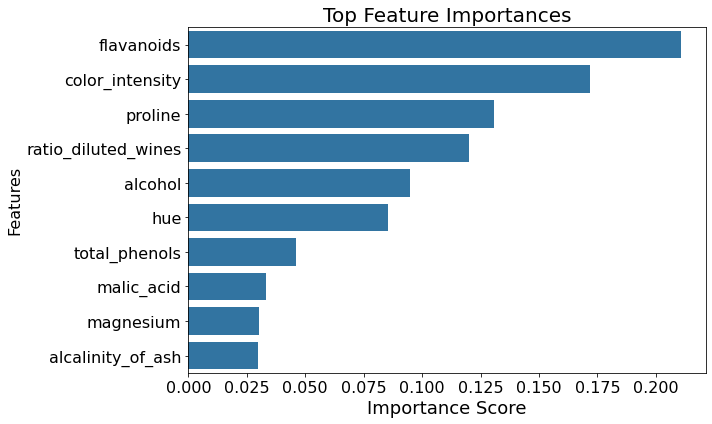

In [142]:
importances_rf = best_rf.feature_importances_
indices_rf = np.argsort(importances_rf)[::-1]
top_n = 10  # Number of top features to display

plt.figure(figsize=(10, 6))
sns.barplot(
    x=importances_rf[indices_rf[:top_n]],
    y=X.columns[indices_rf[:top_n]]
)
plt.title("Top Feature Importances", fontsize=20)
plt.xlabel("Importance Score", fontsize=18)
plt.ylabel("Features", fontsize=16)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.tight_layout()
plt.show()


### AUCROC analysis for a Multiclass problem

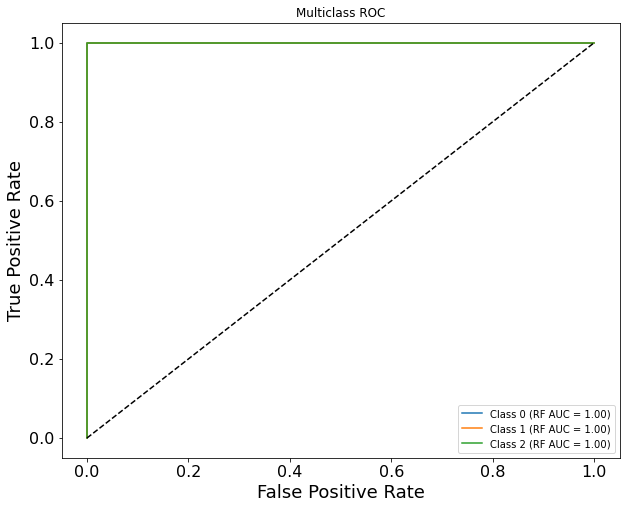

In [143]:
from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_curve, auc
from sklearn.multiclass import OneVsRestClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.metrics import RocCurveDisplay

# Binarize labels
y_test_bin = label_binarize(y_test, classes=np.unique(y))

n_classes = y_test_bin.shape[1]
y_score_rf = best_rf.predict_proba(X_test_scaled)

fpr = dict()
tpr = dict()
roc_auc = dict()

plt.figure(figsize=(10, 8))
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_score_rf[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (RF AUC = {roc_auc[i]:.2f})')

plt.plot([0, 1], [0, 1], 'k--')
plt.title('Multiclass ROC')
plt.xlabel('False Positive Rate', fontsize=18)
plt.ylabel('True Positive Rate', fontsize=18)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.legend()
plt.grid(False)
plt.show()


### Train with XGBoost Classifier

In [144]:
xgb = XGBClassifier(use_label_encoder=False, eval_metric='mlogloss', random_state=42)
param_grid_xgb = {
    'n_estimators': [100, 200],
    'max_depth': [3, 6],
    'learning_rate': [0.05, 0.1]
}

grid_xgb = GridSearchCV(xgb, param_grid_xgb, cv=5, scoring='f1_macro', n_jobs=-1)
grid_xgb.fit(X_train_scaled, y_train)

C:\Users\Hp\anaconda3\Lib\site-packages\xgboost\core.py:158: UserWarning: [15:02:13] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


GridSearchCV(cv=5,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     callbacks=None, colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, device=None,
                                     early_stopping_rounds=None,
                                     enable_categorical=False,
                                     eval_metric='mlogloss', feature_types=None,
                                     gamma=None, grow_policy=None,
                                     importance_type=None,
                                     interaction_constraints=None,
                                     learning_rate...
                                     max_cat_threshold=None,
                                     max_cat_to_onehot=None,
                                     max_delta_step=None, max_depth=None,
                                     max_leaves=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     multi_strategy=None, n_estimators=None,
                                     n_jobs=None, num_parallel_tree=None,
                                     random_state=42, ...),
             n_jobs=-1,
             param_grid={'learning_rate': [0.05, 0.1], 'max_depth': [3, 6],
                         'n_estimators': [100, 200]},
             scoring='f1_macro')

In [145]:
# Best model parameters
best_xgb =grid_xgb.best_estimator_
print("Best XGBoost Parameters:", grid_xgb.best_params_)


Best XGBoost Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100}


In [146]:
# Evaluate
y_pred_xgb = best_xgb.predict(X_test_scaled)
print("\nRandom Forest Classification Report:")
print(classification_report(y_test, y_pred_xgb))



Random Forest Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        14
           1       0.93      1.00      0.97        14
           2       1.00      0.88      0.93         8

    accuracy                           0.97        36
   macro avg       0.98      0.96      0.97        36
weighted avg       0.97      0.97      0.97        36



### Feature Importance Analysis

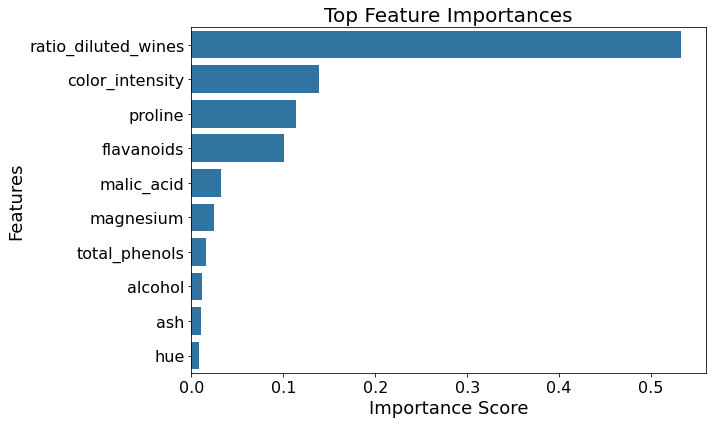

In [147]:
importances_xgb = best_xgb.feature_importances_
indices_xgb = np.argsort(importances_xgb)[::-1]

plt.figure(figsize=(10, 6))
sns.barplot(
    x=importances_xgb[indices_xgb[:top_n]],
    y=X.columns[indices_xgb[:top_n]]
)
plt.title("Top Feature Importances", fontsize=20)
plt.xlabel("Importance Score", fontsize=18)
plt.ylabel("Features", fontsize=18)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.tight_layout()
plt.show()


#### AUROC Analysis

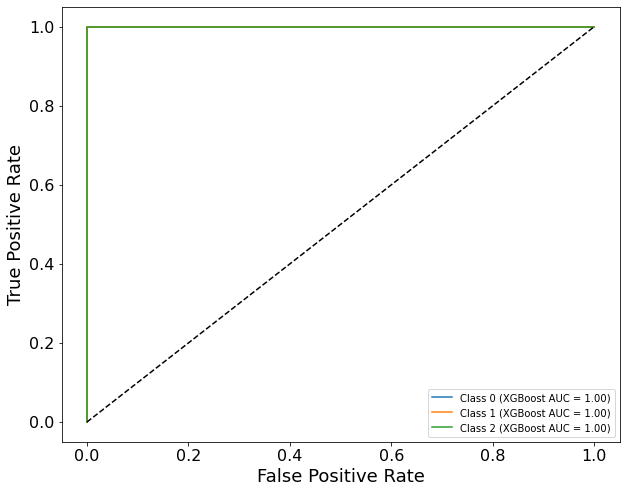

In [148]:
# Binarize test labels (using y_test)
y_test_bin = label_binarize(y_test, classes=np.unique(y))
n_classes = y_test_bin.shape[1]

# Get prediction probabilities for XGBoost
y_score_xgb = best_xgb.predict_proba(X_test_scaled)

# Plot ROC curves for each class
fpr = dict()
tpr = dict()
roc_auc = dict()

plt.figure(figsize=(10, 8))
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_score_xgb[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (XGBoost AUC = {roc_auc[i]:.2f})')

plt.plot([0, 1], [0, 1], 'k--')
#plt.title('Multiclass ROC - XGBoost')
plt.xlabel('False Positive Rate', fontsize=18)
plt.ylabel('True Positive Rate', fontsize=18)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.legend()
plt.grid(False)
plt.show()

#### Post-hoc Model Interpretation

In [149]:
best_xgb = best_xgb

In [150]:
import shap
import matplotlib.pyplot as plt

# Ensure SHAP JS visualization works (for notebooks)
shap.initjs()

# Convert to DataFrame to restore column names

X_train_scaled_df = pd.DataFrame(X_train_scaled, columns=X.columns)

X_test_scaled_df = pd.DataFrame(X_test_scaled, columns=X.columns)



# Use the SHAP explainer
explainer = shap.Explainer(best_xgb, X_train_scaled_df)


In [151]:
shap_value_xgb = explainer(X_test_scaled_df)

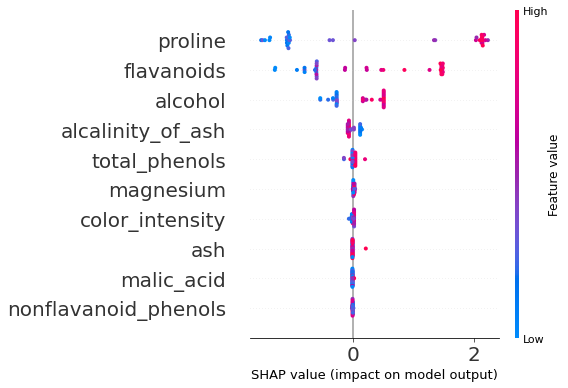

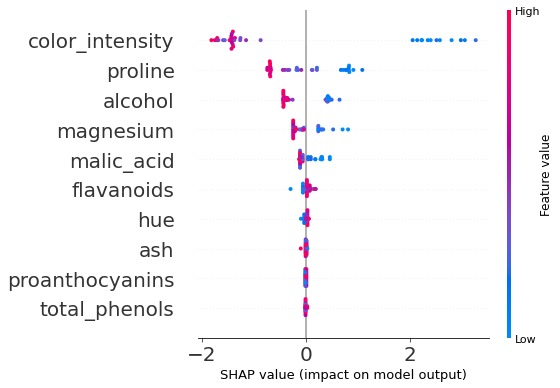

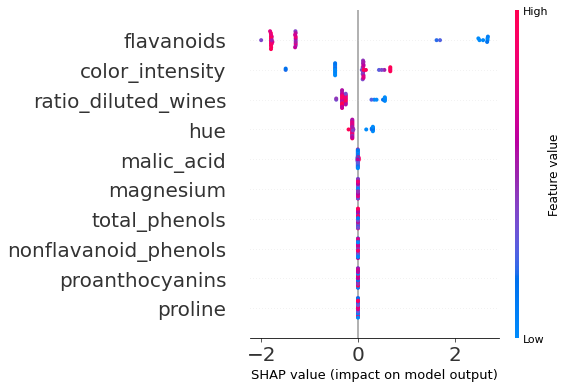

In [152]:
import shap
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Ensure X_test_scaled has feature names
X_df = pd.DataFrame(X_test_scaled, columns=X.columns)

# Class names
class_names = ["1", "2", "3"]

# Loop through each class
for i, class_name in enumerate(class_names):
    # Convert Explanation object to raw SHAP values array
    shap_values_class = shap_value_xgb[..., i].values  # shape: (n_samples, n_features)
    
    # Compute mean absolute SHAP values to rank features
    mean_abs_shap = np.abs(shap_values_class).mean(axis=0)
    
    # Get top 10 feature indices and names
    top10_indices = np.argsort(mean_abs_shap)[-10:][::-1]
    top10_features = X_df.columns[top10_indices]

    # Subset SHAP values and input features
    shap_subset = shap_values_class[:, top10_indices]
    X_subset = X_df[top10_features]

    # Plot SHAP summary
    shap.summary_plot(shap_subset, X_subset, plot_type='dot', show=False)
    
    # Style and save
    plt.gca().tick_params(labelsize=20)
    #plt.title(f'SHAP Summary Plot (Dot) for {class_name}', fontsize=20)
    plt.tight_layout()
    #plt.savefig(path + f'{class_name}_test_SHAP_xgb_summary_plot.svg', bbox_inches='tight')
    plt.show()


#### LIME Explanations

In [153]:
# Create a LIME explainer
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train_scaled_df.values, 
    feature_names=X_train_scaled_df.columns.tolist(),
    class_names=["1", "2", "3"],  # Class names
    mode='classification',  # For classification problems
    discretize_continuous=True  # Handle continuous variables appropriately
)


In [154]:
# Function to predict for LIME
def predict_fn(X):
    return best_xgb.predict_proba(X)

# Select a sample to explain (for example, the first sample)
sample_idx = 0
sample_instance = X_test_scaled_df.iloc[sample_idx].values.reshape(1, -1)

In [155]:
# Explain the instance
explanation = explainer.explain_instance(sample_instance[0], predict_fn)


In [156]:
# Visualize the explanation
explanation.show_in_notebook(show_table=True, show_all=False)

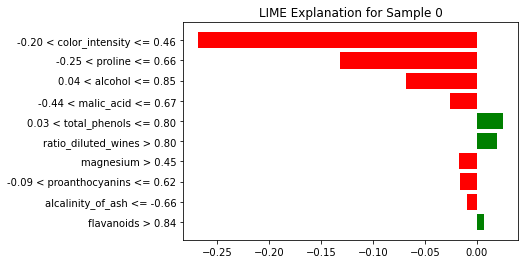

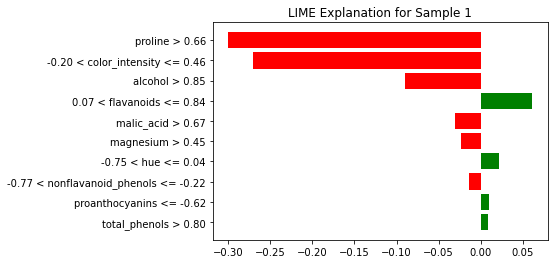

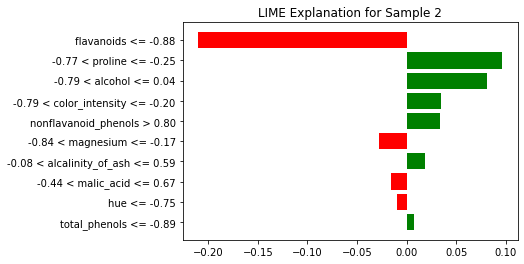

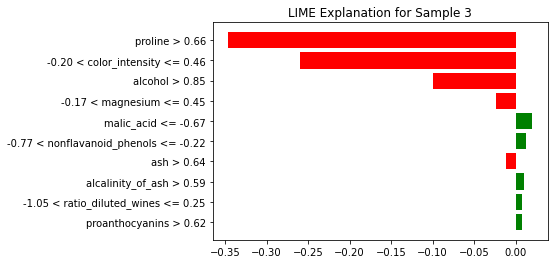

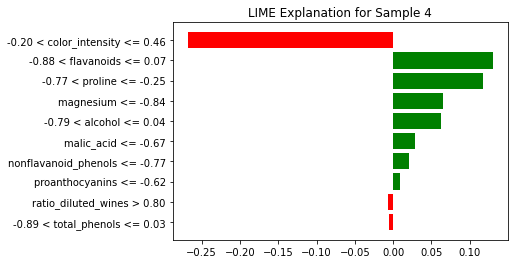

In [157]:
# Loop through the first few test instances and explain each
for sample_idx in range(5):  # Explaining first 5 samples
    sample_instance = X_test_scaled_df.iloc[sample_idx].values.reshape(1, -1)
    explanation = explainer.explain_instance(sample_instance[0], predict_fn)
    fig = explanation.as_pyplot_figure()
    plt.title(f"LIME Explanation for Sample {sample_idx}")
    plt.show()

### Domain Knowledge Interpretations

In [158]:
path = "/Users/Hp/Downloads/"
# Dictionary to store top 10 features for each class
top_10_features = {}

# Loop through each class
for i, class_name in enumerate(class_names):
    # Extract SHAP values for the current class
    shap_values_class = shap_value_xgb[..., i].values  # shape: (n_samples, n_features)
    
    # Create a DataFrame for feature importance (mean absolute SHAP values for each feature)
    feature_importance = pd.DataFrame({
        'Feature': X.columns,
        'SHAP Value': np.abs(shap_values_class).mean(axis=0)
    })
    
    # Sort the features by SHAP value and get the top 10
    feature_importance = feature_importance.sort_values(by='SHAP Value', ascending=False).head(13)
    
    # Save top 100 features for each class
    top_10_features[class_name] = feature_importance

    # Save each class's top features as a separate CSV file
    csv_filename = f"top_10_features_{class_name}.csv"
    feature_importance.to_csv(path + csv_filename, index=False)

print("Top 100 features saved as individual CSV files.")


Top 100 features saved as individual CSV files.



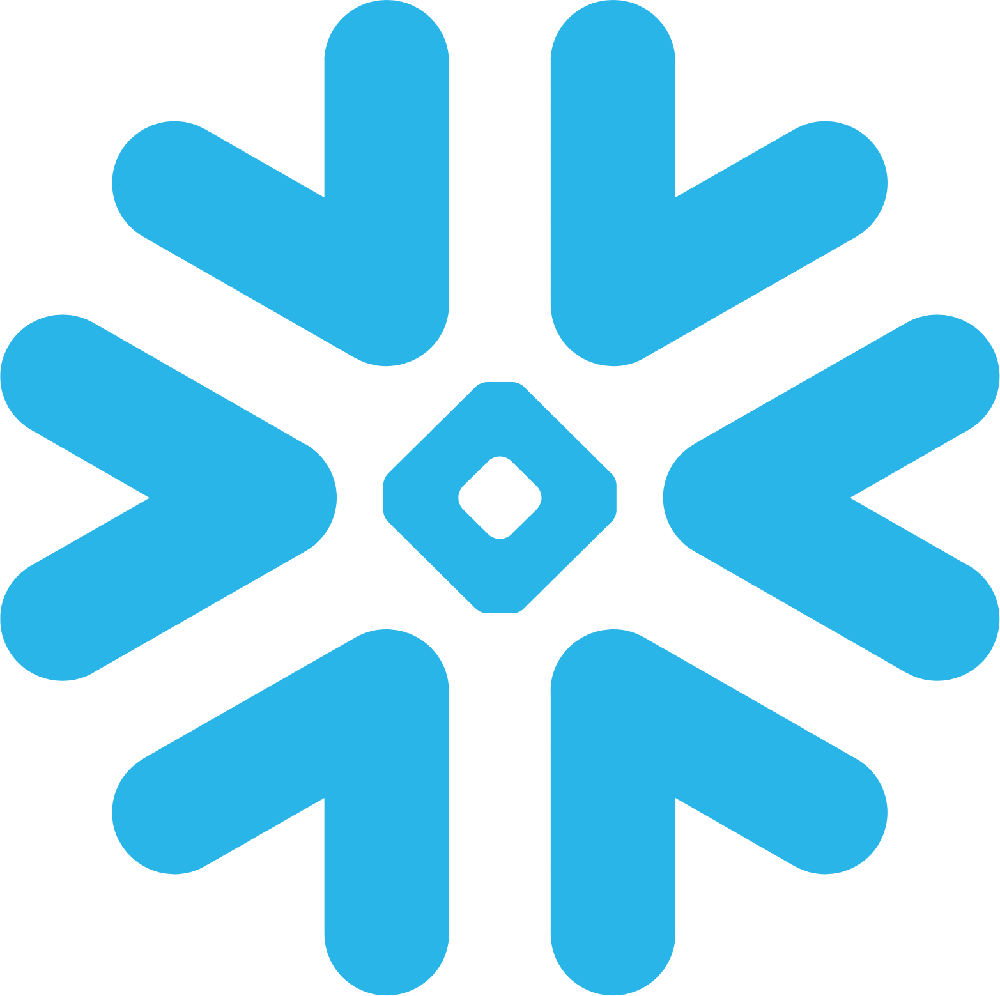

In [159]:
df.head()


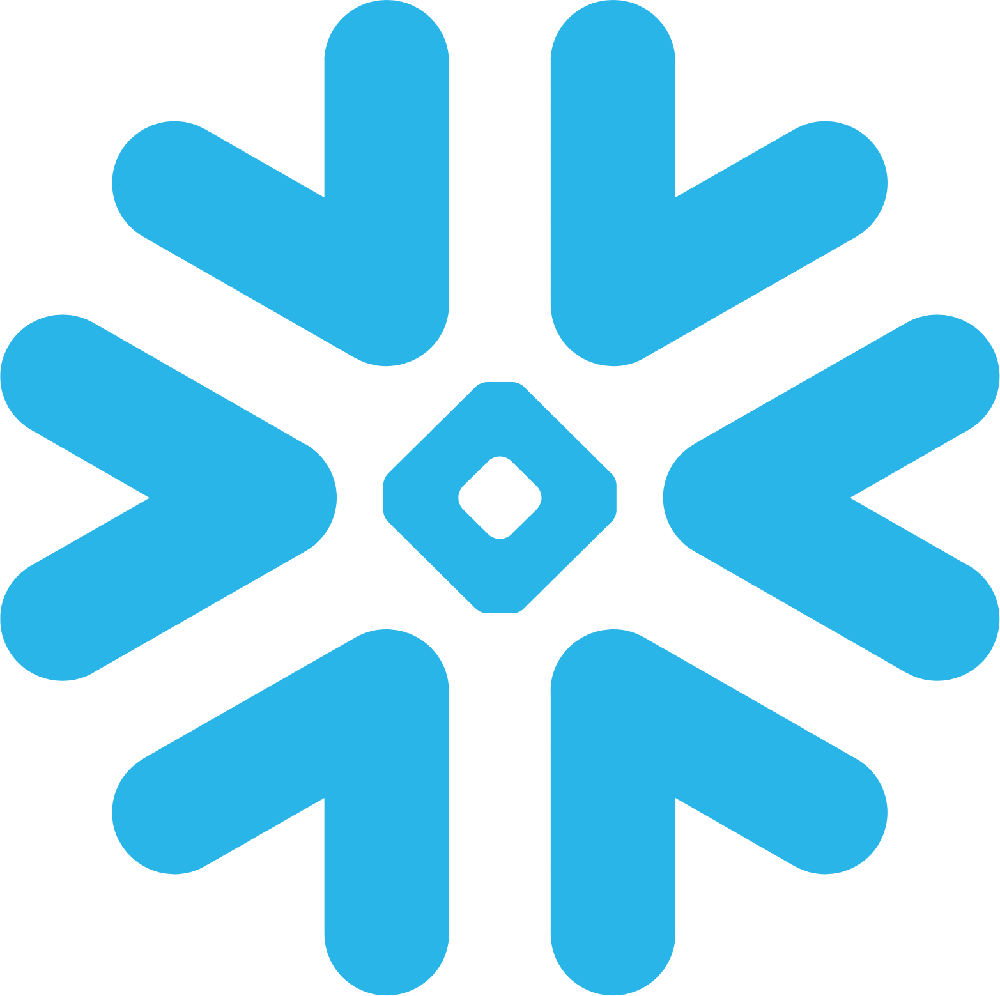

In [160]:
# Load your dataframe
df_shap = pd.read_csv(path+'top_10_features_1.csv')
df_shap.head()


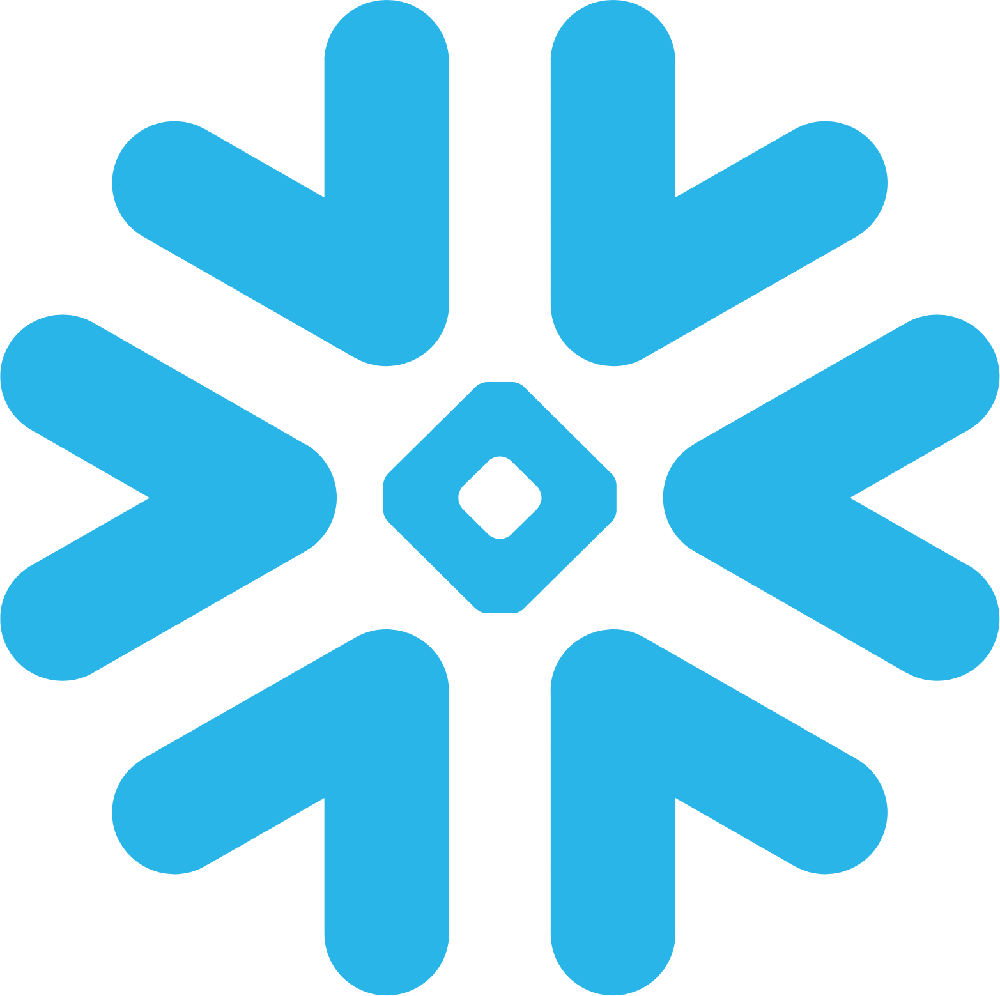

In [161]:
# Extract columns in df2 that match rows in df1['feature']
matching_columns = df_shap['Feature'].values  # Get the list of column names from df1
extracted_df = df[matching_columns]      # Extract matching columns from df2

# Output the resulting DataFrame
extracted_df.head()

### Visualise Interactive Network from SHAP top Features

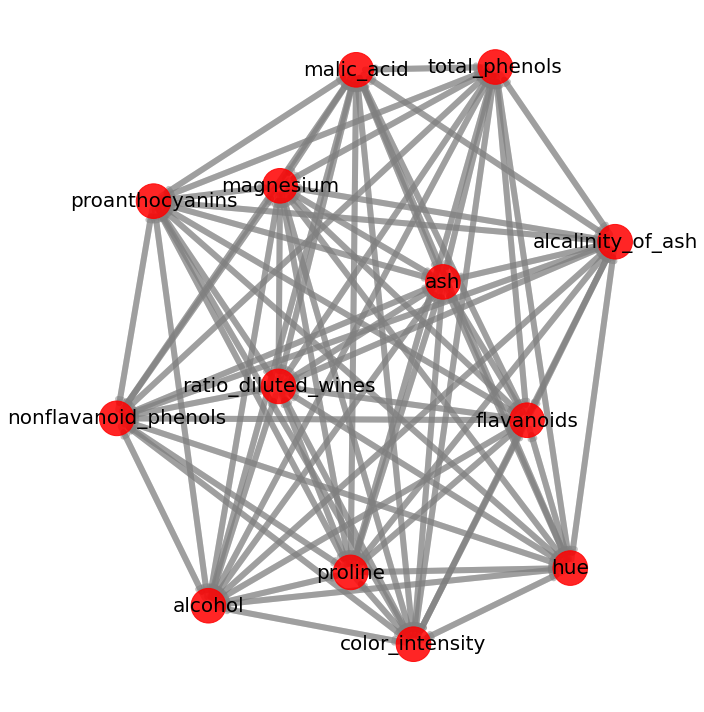

In [162]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx

# Binarize data: 1 = disease present
df_binarized = (extracted_df > 0).astype(int)

# Co-occurrence matrix
cooccurrence_matrix = np.dot(df_binarized.T, df_binarized)

# Create graph
G = nx.DiGraph()
G.add_nodes_from(df_binarized.columns)

# Add edges with weight ≥ threshold
cooccurrence_threshold = 3  # keep edges where disease co-occurred in ≥3 patients
for i in range(len(cooccurrence_matrix)):
    for j in range(len(cooccurrence_matrix)):
        if i != j and cooccurrence_matrix[i, j] >= cooccurrence_threshold:
            G.add_edge(
                df_binarized.columns[i],
                df_binarized.columns[j],
                weight=cooccurrence_matrix[i, j]
            )

# Layout for visualization
pos = nx.spring_layout(G, k=0.20, iterations=50)  # spring layout for node positioning

# Node degrees and sizes (increase multiplier for larger nodes)
degrees = dict(G.degree())
node_sizes = [degrees[node] * 50 for node in G.nodes()]  # Increased size multiplier to 50

# Edge widths based on weight
weights = [min(data['weight'] * 0.05, 6) for _, _, data in G.edges(data=True)]

# Plot
plt.figure(figsize=(10, 10))  # Increase figure size for better readability
nx.draw_networkx_nodes(G, pos, node_size=node_sizes, node_color='red', alpha=0.85)
nx.draw_networkx_edges(G, pos, edge_color='gray', alpha=0.5, width=weights, arrows=True)

# Node labels with increased font size
for node, (x, y) in pos.items():
    plt.text(x, y, node, fontsize=20, ha='center', va='center', color='black')  # Increased fontsize

plt.axis('off')
plt.tight_layout()

# Save plot
# plt.savefig(path + "visualise_networks.svg", bbox_inches='tight')  # Uncomment to save the plot

plt.show()
